In [15]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [16]:
import matplotlib.pyplot as plt
import torch
import numpy as np
from torch.optim import Adam
from torch.utils.data import TensorDataset, DataLoader
from tqdm import tqdm
import sys
import os

import torch
import torchsde
from functorch import vmap
from torchdiffeq import odeint
# Get the parent directory and add it to sys.path
parent_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))

if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)
import dem
from dem.models.components.mlp import MyMLP


from dem.energies.gmm_energy import GMM

In [17]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
target = GMM(dimensionality=2,
             n_mixes=40,
             loc_scaling= 40,
             log_var_scaling=1.0,
             device=device,
             should_unnormalize=True)


cuda


In [18]:
from dem.models.components.sdes import VEReverseSDE
from dem.models.components.sde_integration import integrate_sde
from dem.models.components.clipper import Clipper
from dem.models.components.score_estimator import estimate_grad_Rt
from dem.models.components.noise_schedules import GeometricNoiseSchedule, LinearNoiseSchedule
from dem.energies.base_prior import Prior
# noise_schedule = GeometricNoiseSchedule(sigma_min=0.000004, sigma_max=0.4)
beta = torch.tensor(0.2).to(device)
noise_schedule = LinearNoiseSchedule(beta)
clipper = Clipper(
    should_clip_scores=False, should_clip_log_rewards=False, max_score_norm=50
)

prior = Prior(dim=2, device=device, scale = noise_schedule.h(1) ** 0.5)

In [19]:
# calculate the log expectation of the reward
def log_E_R(_x, _t, noise_schedule, num_mc_samples, var_exploding=True):
    repeated_x = _x.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0)
    repeated_t = _t.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0)
    h_t  = noise_schedule.h(repeated_t) 
    h_t = h_t.unsqueeze(1)

    samples = repeated_x + torch.randn(repeated_x.shape).to(device) * (h_t ** 0.5)
    # log_rewards = target(target.unnormalize(samples))
    log_rewards = target(samples)
    log_expectation_R = torch.logsumexp(log_rewards, dim=-1) - np.log(num_mc_samples)
    return log_expectation_R

In [20]:
def estimate_grad_Rt(x, t, noise_schedule, num_mc_samples=100, var_exploding=True, richardson=False):
    est_scores_n = torch.func.grad(log_E_R)(x, t, noise_schedule, num_mc_samples, var_exploding=var_exploding)
    if richardson:
        est_scores_n_div2 = torch.func.grad(log_E_R)(x, t, noise_schedule, num_mc_samples//2, 
                                                                                         var_exploding=var_exploding)
        return (2*est_scores_n - est_scores_n_div2)
    else:
        return est_scores_n

In [21]:
# calculate the log expectation of the reward
def estimate_grad_Rt_2(_x, _t, noise_schedule, num_mc_samples=100):
    
    # import pdb; pdb.set_trace()
    repeated_x = _x.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0).to(device)
    repeated_t = _t.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0).to(device)
    h_t  = noise_schedule.h(repeated_t).unsqueeze(1).to(device)
    
    samples = repeated_x + torch.randn(repeated_x.shape, device=device).to(device) * (h_t ** 0.5)
    log_rewards = target(samples)
    log_w = log_rewards
    # grad_log_rewards = torch.vmap(torch.func.grad(lambda x: target(x)))(samples)
    grad_log_rewards =  (samples - repeated_x) / h_t
    
    estimate = torch.sum(torch.nn.functional.softmax(log_w, dim=0)[:, None] * grad_log_rewards, dim=-2)
    return estimate

def estimate_grad_Rt_2_batch(_x, _t, noise_schedule, num_mc_samples=100):
    
    # Handle batched inputs: _x shape [batch_size, dim], _t shape [batch_size]
    batch_size = _x.shape[0]
    
    # Reshape for MC sampling: [batch_size, num_mc_samples, dim]
    repeated_x = _x.unsqueeze(1).repeat(1, num_mc_samples, 1)
    repeated_t = _t.unsqueeze(1).repeat(1, num_mc_samples)
    
    # Flatten for processing: [batch_size * num_mc_samples, dim]
    repeated_x_flat = repeated_x.view(-1, _x.shape[-1])
    repeated_t_flat = repeated_t.view(-1)
    
    h_t = noise_schedule.h(repeated_t_flat).unsqueeze(1)
    
    samples = repeated_x_flat + torch.randn(repeated_x_flat.shape, device=device) * (h_t ** 0.5)
    log_rewards = target(samples)
    
    # Reshape back: [batch_size, num_mc_samples]
    log_rewards = log_rewards.view(batch_size, num_mc_samples)
    
    # Compute gradient estimate
    grad_log_rewards = (samples - repeated_x_flat) / h_t
    grad_log_rewards = grad_log_rewards.view(batch_size, num_mc_samples, -1)
    
    # Weighted average over MC samples
    weights = torch.nn.functional.softmax(log_rewards, dim=1)
    estimate = torch.sum(weights.unsqueeze(-1) * grad_log_rewards, dim=1)
    
    return estimate

In [22]:
# calculate the log expectation of the reward
def estimate_grad_Rt_3(_x, _t, _x_target_samples, noise_schedule, num_mc_samples=500):
    repeated_x = _x.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0)
    repeated_t = _t.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0)
    h_t  = noise_schedule.h(repeated_t)

    log_weights = -torch.linalg.vector_norm((_x_target_samples - repeated_x), dim=-1) ** 2 / (2 * h_t)

    grad_log_rewards = torch.vmap(torch.func.grad(lambda x: target(x)))(_x_target_samples)

    estimate = torch.sum(torch.nn.functional.softmax(log_weights, dim=0)[:, None] * grad_log_rewards, dim=-2)

    return estimate, _x_target_samples

In [23]:
# calculate the log expectation of the reward
def estimate_grad_Rt_4(_x, _t, _x_target_samples, noise_schedule, num_mc_samples=500):
    repeated_x = _x.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0)
    repeated_t = _t.unsqueeze(0).repeat_interleave(num_mc_samples, dim=0)
    h_t  = noise_schedule.h(repeated_t)

    log_weights = -torch.linalg.vector_norm((_x_target_samples - repeated_x), dim=-1) ** 2 / (2 * h_t)

    grad_log_transition_kernel =  (_x_target_samples - repeated_x) / h_t.unsqueeze(1)

    estimate = torch.sum(torch.nn.functional.softmax(log_weights, dim=0)[:, None] * grad_log_transition_kernel, dim=-2)

    return estimate, _x_target_samples

In [24]:
class VEReverseSDE(torch.nn.Module):
    noise_type = 'diagonal'
    sde_type = 'ito'
    
    def __init__(self, score, noise_schedule):
        super().__init__()
        self.score = score
        self.noise_schedule = noise_schedule
    
    def f(self, t, x):
        with torch.enable_grad():
            if t.dim() == 0:
                # repeat the same time for all points if we have a scalar time
                t = t * torch.ones(x.shape[0]).to(device)

            # uncomment for true     
            # x.requires_grad = True
            # score = self.score(x, 1-t, self.noise_schedule)


            num_mc_samples = 500
            target_samples = target.gmm.sample((x.shape[0] * num_mc_samples, 1))
            target_samples = target.normalize(target_samples)
            target_samples = target_samples.reshape(x.shape[0], num_mc_samples, -1).to(device)
            # score, _ = torch.vmap(self.score, randomness="different", in_dims=(0,0,0,None))(x, t, target_samples, self.noise_schedule)
            score  = torch.vmap(self.score, randomness="different", in_dims=(0,0,None))(x, t, self.noise_schedule)
            
        return self.g(t, x)**2 * score 
    
    # def g(self, t, x=None):
    #     return self.noise_schedule.g(t.unsqueeze(1))
    
    def g(self, t, x):
        g = self.noise_schedule.g(t)
        return g.unsqueeze(1) if g.ndim > 0 else torch.full_like(x, g)

In [25]:
def reward_matching_loss_biased(vectorfield, energy_fn, x, t, noise_schedule,
                                weighted=False, num_mc_samples=100):
    h_t = noise_schedule.h(t.unsqueeze(1))

    # x.requires_grad = True
    # noisy sample: x(t)
    noisy_x = torch.normal(x, h_t**0.5)
    pred_scores = vectorfield(t, noisy_x)

    # estimated_scores = estimate_grad_Rt_2(noisy_x, t, noise_schedule, num_mc_samples=num_mc_samples).detach()
    estimated_scores = torch.vmap(estimate_grad_Rt_2, in_dims=(0, 0, None), randomness="different")(noisy_x,
                                                                                                    t,
                                                                                                    noise_schedule,
                                                                                                    num_mc_samples=num_mc_samples
                                                                                                    ).detach()
    estimated_scores = clipper.clip_scores(estimated_scores)

    if weighted:
        lambda_t = h_t + 1e-3
        err = (
            estimated_scores - pred_scores
        ) ** 2  # torch.linalg.vector_norm((estimated_scores - pred_scores), dim=-1)**2
        return (lambda_t * err).mean()
    else:
        err = (
            estimated_scores - pred_scores
        ) ** 2  # torch.linalg.vector_norm((estimated_scores - pred_scores), dim=-1)**2
        return err.mean()

In [26]:
def generate_samples(reverse_sde, num_samples, return_full_trajectory, diffusion_scale):
    samples = prior.sample(num_samples)
    return integrate(
        reverse_sde=reverse_sde,
        samples=samples,
        return_full_trajectory=return_full_trajectory,
        diffusion_scale = diffusion_scale
    )


def integrate(reverse_sde, samples, return_full_trajectory=False, diffusion_scale=1.0):
    trajectory = integrate_sde(
        reverse_sde,
        samples,
        1000,
        target,
        reverse_time=True,
        diffusion_scale=diffusion_scale
    )
    if return_full_trajectory:
        return trajectory
    return trajectory[-1]

In [27]:

x1_samples = prior.sample(1000).to(device)
# x1_energy = target(x1_samples)
# target.get_dataset_fig(target.unnormalize(x1_samples))

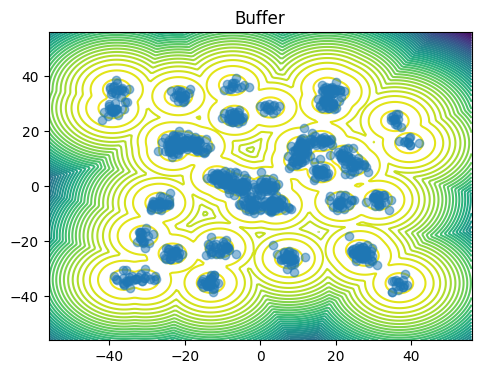

In [28]:
noise_schedule = LinearNoiseSchedule(beta)
ve_reverse_sde = VEReverseSDE(estimate_grad_Rt_2, noise_schedule)
samples = integrate(ve_reverse_sde, x1_samples, return_full_trajectory=True, diffusion_scale=1.0)
target.get_dataset_fig(target.unnormalize(samples[-1]));

In [29]:
from dem.models.components.prioritised_replay_buffer import SimpleBuffer
buffer = SimpleBuffer(
    2,
    10000,
    1000,
    initial_sampler=None,
    device=device,
    fill_buffer_during_init=False,
    sample_with_replacement=True,
    prioritize=False,
)
target = GMM(dimensionality=2,
             n_mixes=40,
             loc_scaling= 40,
             log_var_scaling=1.0,
             device=device,
             should_unnormalize=True)
x1_samples = prior.sample(1000).to(device)
x1_energy = target(x1_samples)
buffer.add(x1_samples, x1_energy)


Buffer not initialised, expected that checkpoint will be loaded.


In [30]:
outer_epochs= 100
inner_epochs = 100

batch_size = 512
train_dataset = TensorDataset(x1_samples.clone(), x1_energy.clone())
trainloader = DataLoader(train_dataset, batch_size = batch_size, shuffle=True) 

In [31]:
vectorfield = MyMLP().to(device)
optimizer = Adam(vectorfield.parameters(), lr=1e-3)
weighted = False

In [32]:
from dem.models.components.sdes import VEReverseSDE

  0%|          | 0/100 [00:00<?, ?it/s]

Epoch 0 | Loss 24.707958
Epoch 49 | Loss 26.490145
Epoch 98 | Loss 13.481422


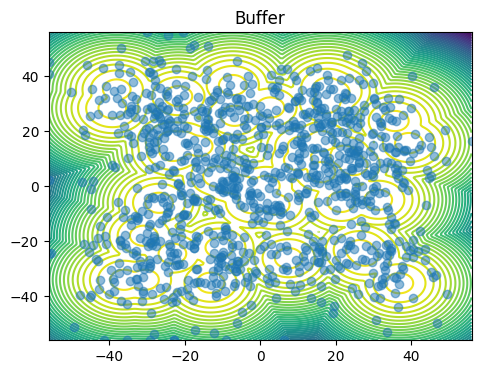

  1%|          | 1/100 [00:02<04:17,  2.60s/it]

Epoch 0 | Loss 20.509373
Epoch 49 | Loss 14.979387
Epoch 98 | Loss 9.167814


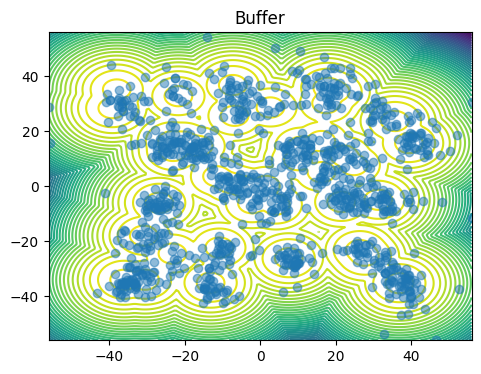

  2%|▏         | 2/100 [00:09<08:24,  5.14s/it]

Epoch 0 | Loss 6.297997
Epoch 49 | Loss 5.932009
Epoch 98 | Loss 5.676893


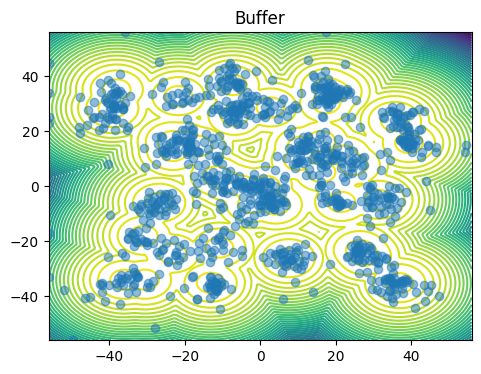

  3%|▎         | 3/100 [00:16<09:37,  5.96s/it]

Epoch 0 | Loss 8.701000
Epoch 49 | Loss 6.459264
Epoch 98 | Loss 3.151251


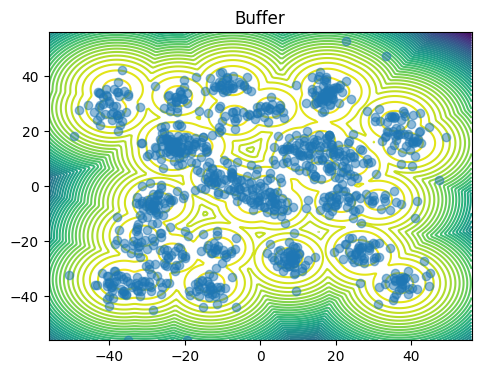

  4%|▍         | 4/100 [00:23<10:08,  6.34s/it]

Epoch 0 | Loss 3.630282
Epoch 49 | Loss 2.903102
Epoch 98 | Loss 5.744233


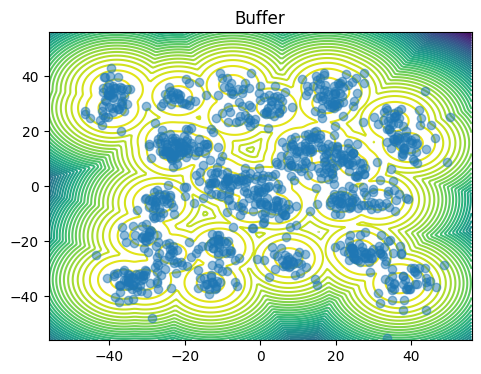

  5%|▌         | 5/100 [00:30<10:23,  6.56s/it]

Epoch 0 | Loss 2.782403
Epoch 49 | Loss 3.711318
Epoch 98 | Loss 6.027085


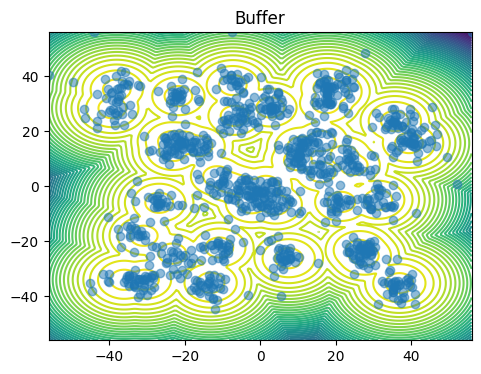

  6%|▌         | 6/100 [00:37<10:29,  6.70s/it]

Epoch 0 | Loss 3.421549
Epoch 49 | Loss 4.072428
Epoch 98 | Loss 4.470210


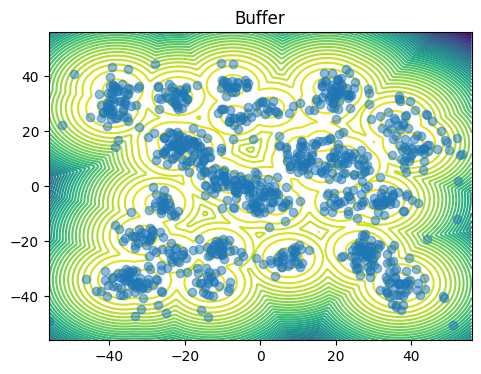

  7%|▋         | 7/100 [00:44<10:29,  6.77s/it]

Epoch 0 | Loss 3.971503
Epoch 49 | Loss 4.763716
Epoch 98 | Loss 4.721660


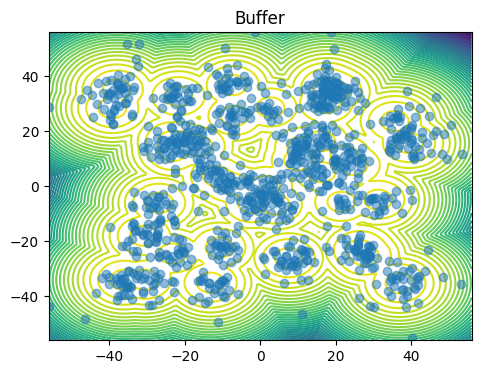

  8%|▊         | 8/100 [00:51<10:29,  6.85s/it]

Epoch 0 | Loss 3.719636
Epoch 49 | Loss 3.974288
Epoch 98 | Loss 3.084860


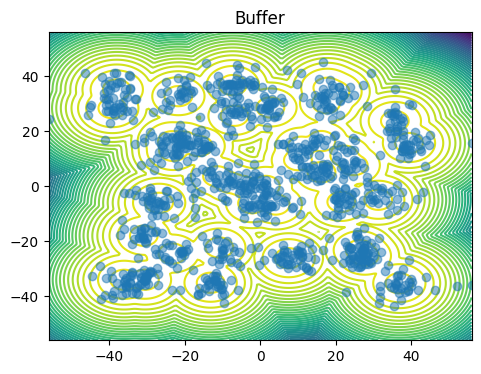

  9%|▉         | 9/100 [00:58<10:26,  6.88s/it]

Epoch 0 | Loss 4.243770
Epoch 49 | Loss 5.326769
Epoch 98 | Loss 4.011743


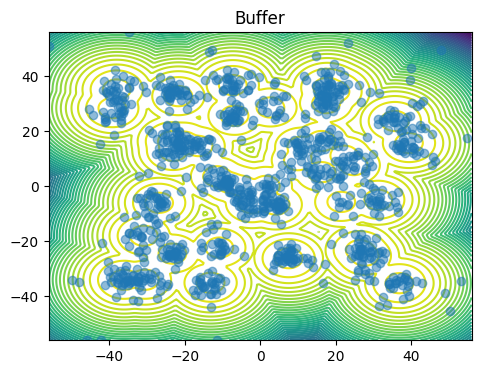

 10%|█         | 10/100 [01:05<10:27,  6.97s/it]

Epoch 0 | Loss 2.287780
Epoch 49 | Loss 5.481977
Epoch 98 | Loss 3.736991


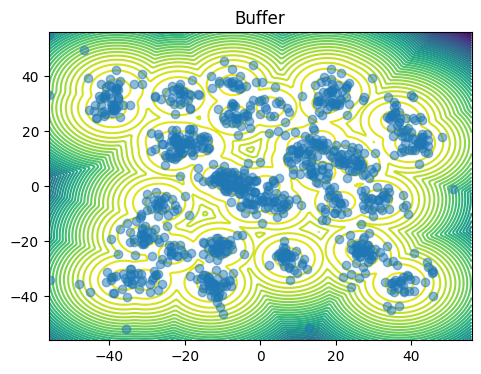

 11%|█         | 11/100 [01:12<10:21,  6.98s/it]

Epoch 0 | Loss 2.522280
Epoch 49 | Loss 3.721882
Epoch 98 | Loss 6.579528


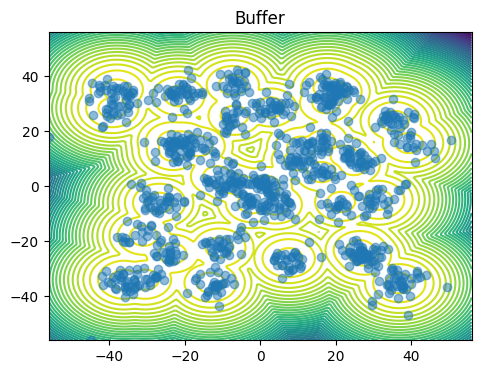

 12%|█▏        | 12/100 [01:19<10:13,  6.97s/it]

Epoch 0 | Loss 3.926379
Epoch 49 | Loss 3.895460
Epoch 98 | Loss 3.220395


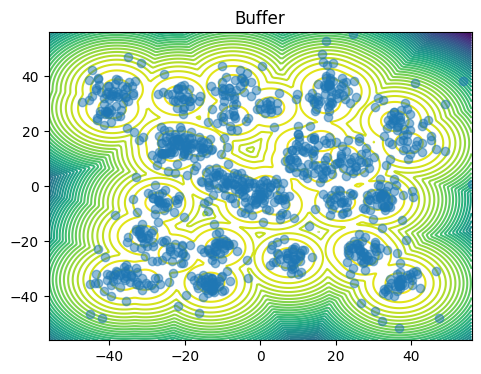

 13%|█▎        | 13/100 [01:26<10:06,  6.97s/it]

Epoch 0 | Loss 3.964884
Epoch 49 | Loss 4.194637
Epoch 98 | Loss 6.327125


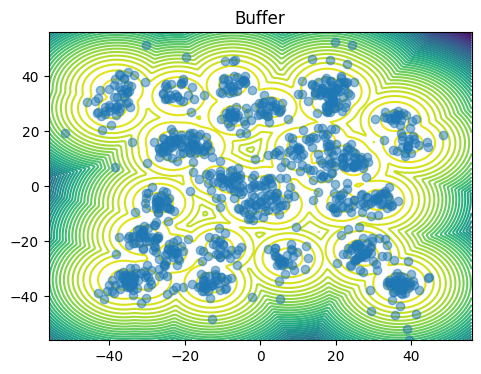

 14%|█▍        | 14/100 [01:33<10:00,  6.99s/it]

Epoch 0 | Loss 3.527773
Epoch 49 | Loss 2.975773
Epoch 98 | Loss 4.570771


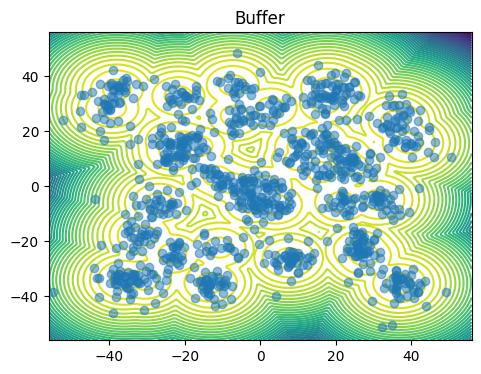

 15%|█▌        | 15/100 [01:40<09:53,  6.98s/it]

Epoch 0 | Loss 3.636991
Epoch 49 | Loss 7.900504
Epoch 98 | Loss 8.183867


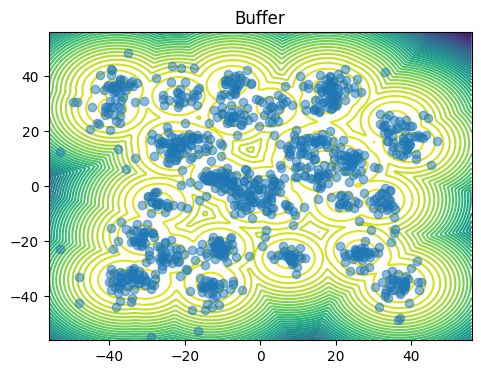

 16%|█▌        | 16/100 [01:47<09:45,  6.97s/it]

Epoch 0 | Loss 2.413911
Epoch 49 | Loss 4.073963
Epoch 98 | Loss 3.223991


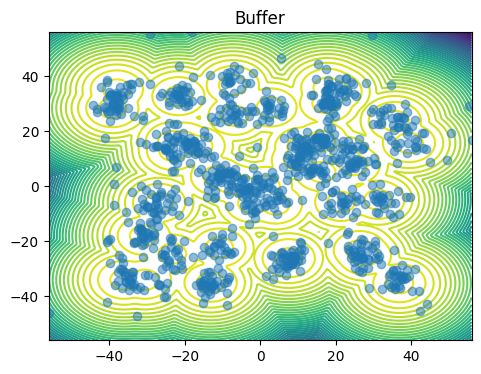

 17%|█▋        | 17/100 [01:54<09:37,  6.96s/it]

Epoch 0 | Loss 4.769612
Epoch 49 | Loss 4.896503
Epoch 98 | Loss 2.932800


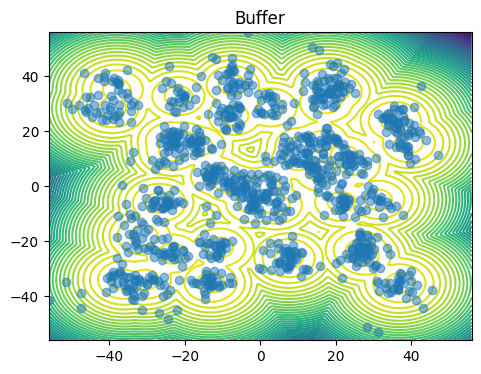

 18%|█▊        | 18/100 [02:01<09:29,  6.95s/it]

Epoch 0 | Loss 2.222569
Epoch 49 | Loss 2.633264
Epoch 98 | Loss 3.217959


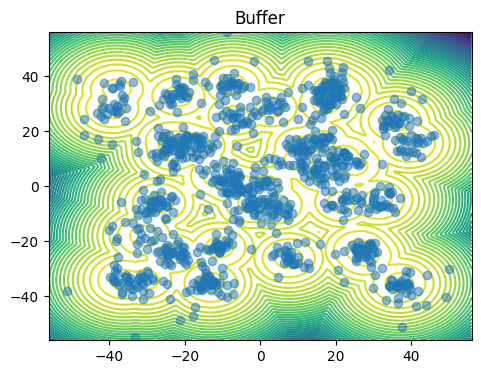

 19%|█▉        | 19/100 [02:07<09:21,  6.93s/it]

Epoch 0 | Loss 3.415831
Epoch 49 | Loss 3.142978
Epoch 98 | Loss 7.045228


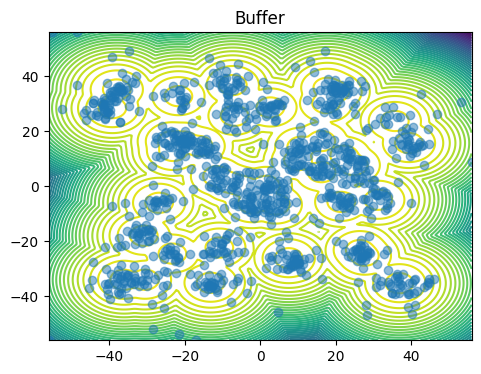

 20%|██        | 20/100 [02:15<09:18,  6.98s/it]

Epoch 0 | Loss 3.653235
Epoch 49 | Loss 2.500854
Epoch 98 | Loss 2.720387


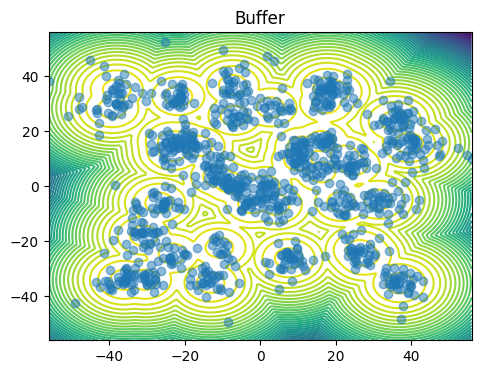

 21%|██        | 21/100 [02:22<09:11,  6.98s/it]

Epoch 0 | Loss 2.346268
Epoch 49 | Loss 2.728167
Epoch 98 | Loss 2.893426


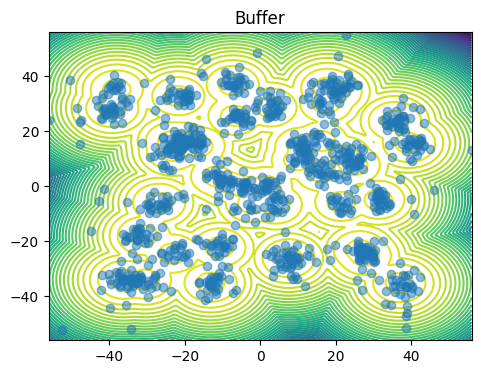

 22%|██▏       | 22/100 [02:28<09:02,  6.96s/it]

Epoch 0 | Loss 2.246222
Epoch 49 | Loss 3.819849
Epoch 98 | Loss 3.422561


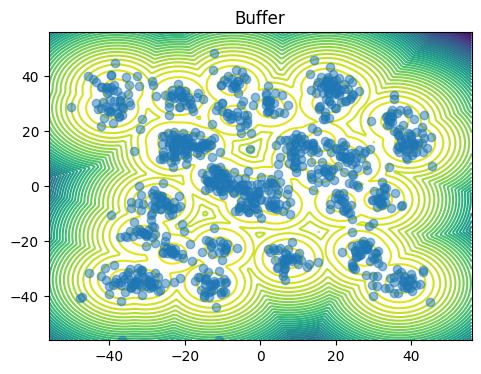

 23%|██▎       | 23/100 [02:35<08:56,  6.97s/it]

Epoch 0 | Loss 2.593164
Epoch 49 | Loss 2.239081
Epoch 98 | Loss 2.377326


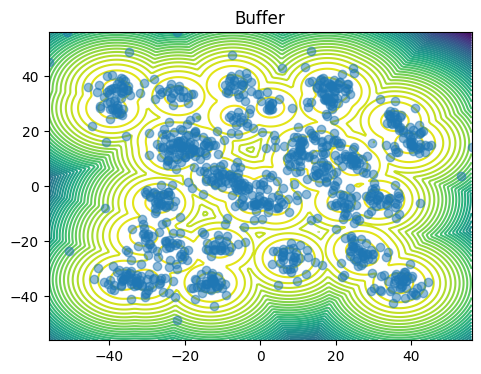

 24%|██▍       | 24/100 [02:42<08:48,  6.96s/it]

Epoch 0 | Loss 3.565526
Epoch 49 | Loss 2.663574
Epoch 98 | Loss 2.773385


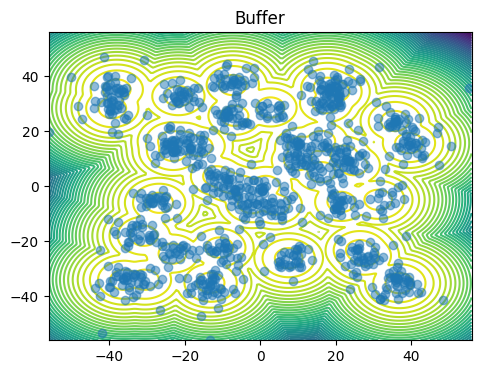

 25%|██▌       | 25/100 [02:49<08:42,  6.97s/it]

Epoch 0 | Loss 2.726839
Epoch 49 | Loss 3.009976
Epoch 98 | Loss 3.619423


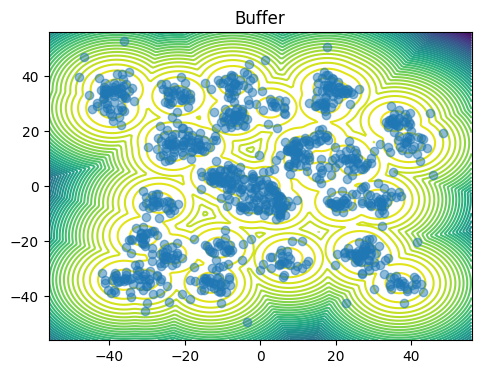

 26%|██▌       | 26/100 [02:56<08:35,  6.97s/it]

Epoch 0 | Loss 3.248738
Epoch 49 | Loss 3.605531
Epoch 98 | Loss 2.532943


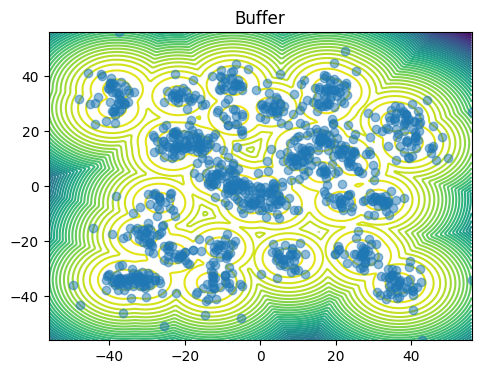

 27%|██▋       | 27/100 [03:03<08:28,  6.97s/it]

Epoch 0 | Loss 3.950269
Epoch 49 | Loss 6.451412
Epoch 98 | Loss 1.879091


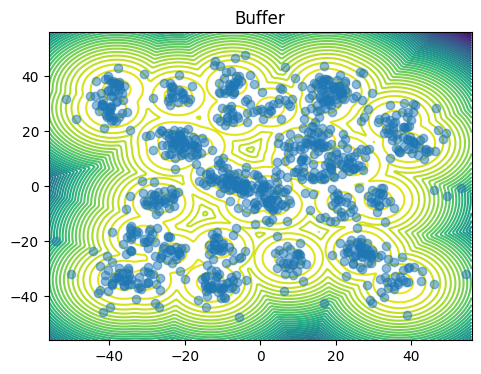

 28%|██▊       | 28/100 [03:10<08:21,  6.97s/it]

Epoch 0 | Loss 3.757767
Epoch 49 | Loss 2.411480
Epoch 98 | Loss 2.544128


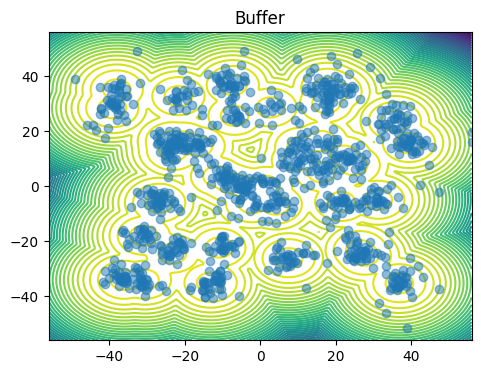

 29%|██▉       | 29/100 [03:17<08:16,  6.99s/it]

Epoch 0 | Loss 2.919006
Epoch 49 | Loss 9.418062
Epoch 98 | Loss 2.342530


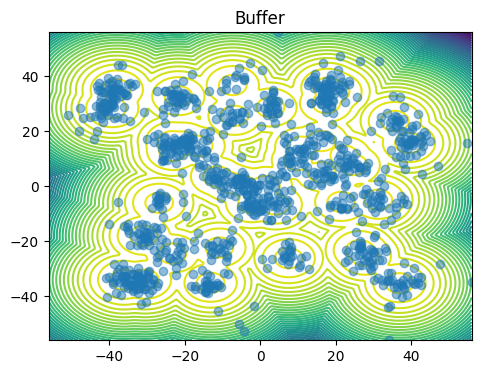

 30%|███       | 30/100 [03:24<08:10,  7.01s/it]

Epoch 0 | Loss 2.106356
Epoch 49 | Loss 2.192785
Epoch 98 | Loss 2.519405


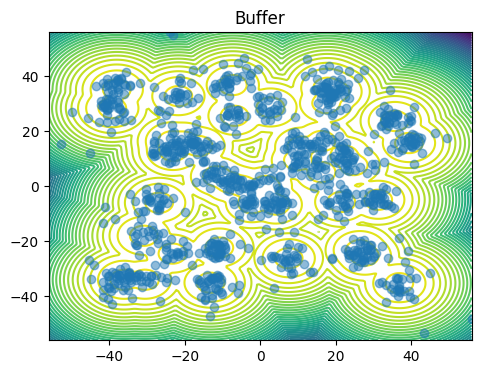

 31%|███       | 31/100 [03:31<08:03,  7.01s/it]

Epoch 0 | Loss 3.413070
Epoch 49 | Loss 2.378817
Epoch 98 | Loss 4.020319


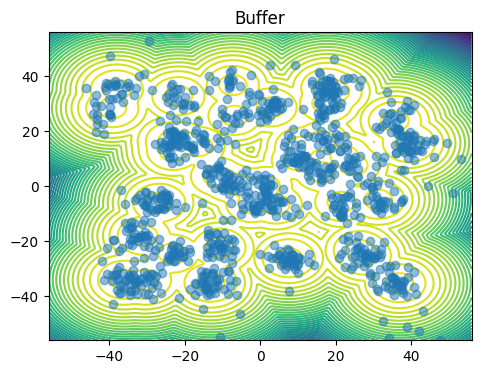

 32%|███▏      | 32/100 [03:38<07:56,  7.01s/it]

Epoch 0 | Loss 2.968945
Epoch 49 | Loss 3.242158
Epoch 98 | Loss 5.298490


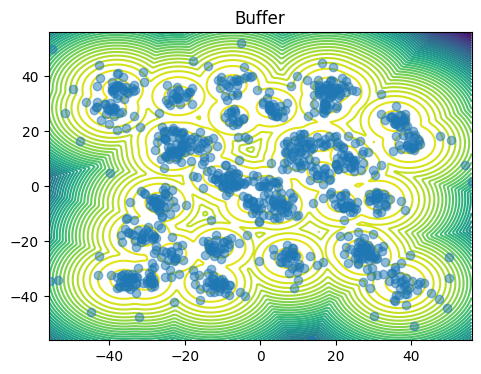

 33%|███▎      | 33/100 [03:45<07:48,  7.00s/it]

Epoch 0 | Loss 3.579381
Epoch 49 | Loss 2.160872
Epoch 98 | Loss 3.475016


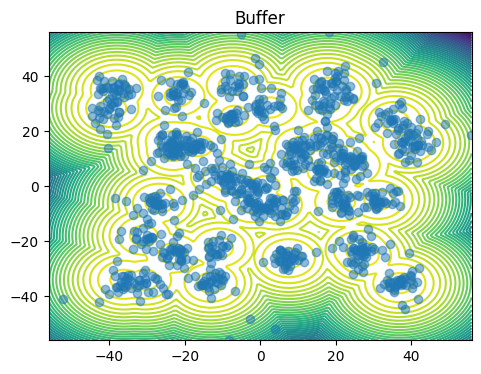

 34%|███▍      | 34/100 [03:53<07:46,  7.07s/it]

Epoch 0 | Loss 3.212503
Epoch 49 | Loss 3.220171
Epoch 98 | Loss 2.676466


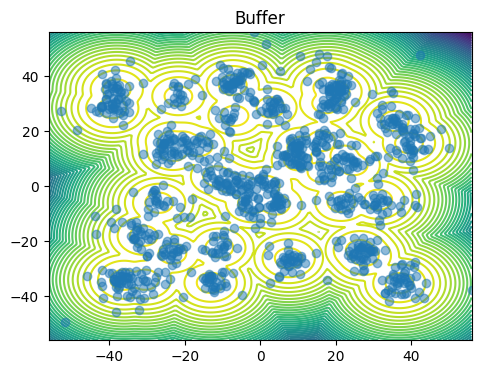

 35%|███▌      | 35/100 [04:00<07:38,  7.06s/it]

Epoch 0 | Loss 4.024206
Epoch 49 | Loss 3.285062
Epoch 98 | Loss 4.422138


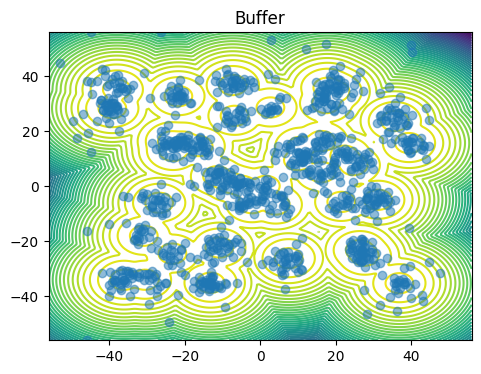

 36%|███▌      | 36/100 [04:07<07:28,  7.01s/it]

Epoch 0 | Loss 2.274283
Epoch 49 | Loss 2.707053
Epoch 98 | Loss 4.628757


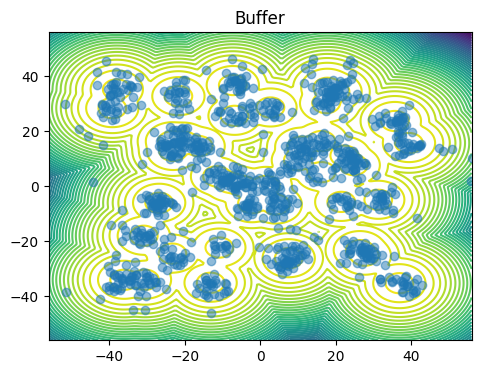

 37%|███▋      | 37/100 [04:13<07:21,  7.01s/it]

Epoch 0 | Loss 2.630132
Epoch 49 | Loss 2.712436
Epoch 98 | Loss 1.966458


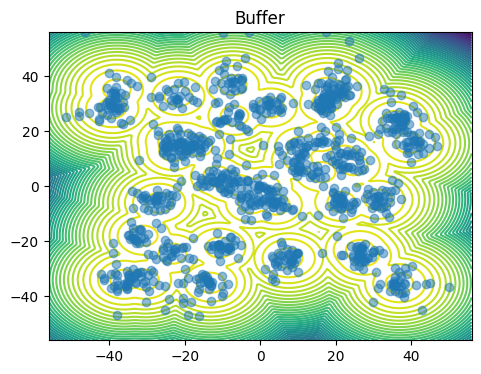

 38%|███▊      | 38/100 [04:21<07:14,  7.01s/it]

Epoch 0 | Loss 1.988830
Epoch 49 | Loss 2.784997
Epoch 98 | Loss 3.214149


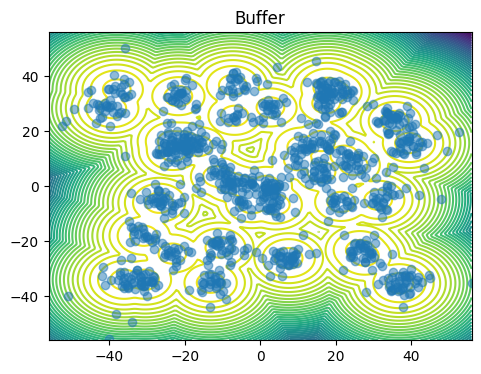

 39%|███▉      | 39/100 [04:28<07:08,  7.02s/it]

Epoch 0 | Loss 2.751641
Epoch 49 | Loss 2.653835
Epoch 98 | Loss 2.547395


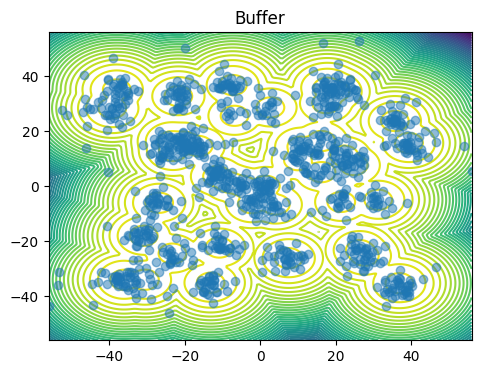

 40%|████      | 40/100 [04:35<07:02,  7.03s/it]

Epoch 0 | Loss 2.258949
Epoch 49 | Loss 2.129911
Epoch 98 | Loss 2.803912


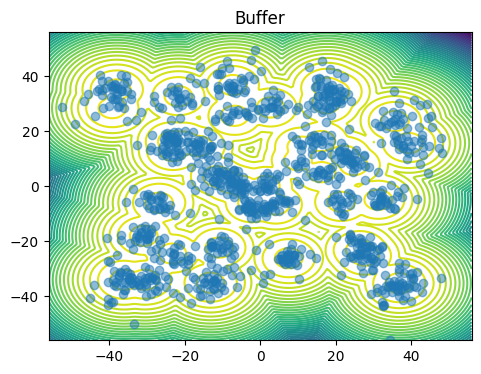

 41%|████      | 41/100 [04:42<06:56,  7.06s/it]

Epoch 0 | Loss 2.646106
Epoch 49 | Loss 2.468740
Epoch 98 | Loss 4.170304


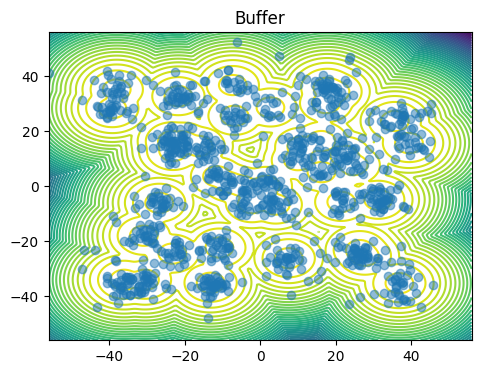

 42%|████▏     | 42/100 [04:49<06:48,  7.04s/it]

Epoch 0 | Loss 2.623188
Epoch 49 | Loss 3.391135
Epoch 98 | Loss 2.632742


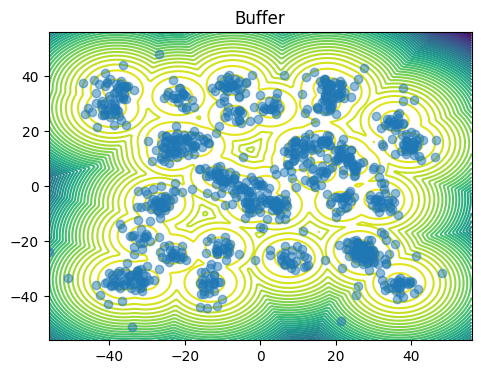

 43%|████▎     | 43/100 [04:56<06:41,  7.05s/it]

Epoch 0 | Loss 5.275335
Epoch 49 | Loss 2.485176
Epoch 98 | Loss 3.087985


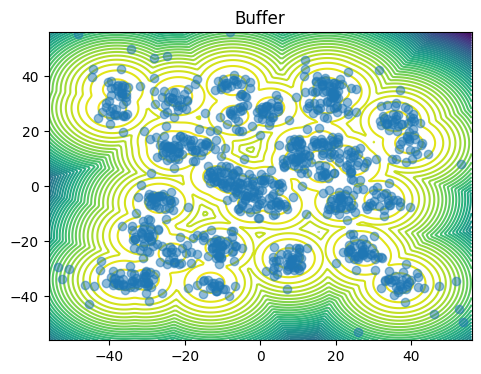

 44%|████▍     | 44/100 [05:03<06:30,  6.98s/it]

Epoch 0 | Loss 3.217352
Epoch 49 | Loss 2.741866
Epoch 98 | Loss 3.112726


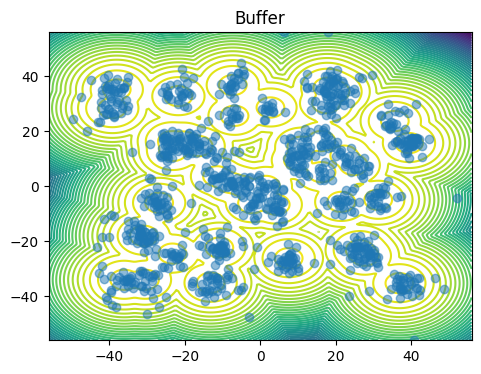

 45%|████▌     | 45/100 [05:10<06:26,  7.02s/it]

Epoch 0 | Loss 2.259201
Epoch 49 | Loss 3.823026
Epoch 98 | Loss 2.832468


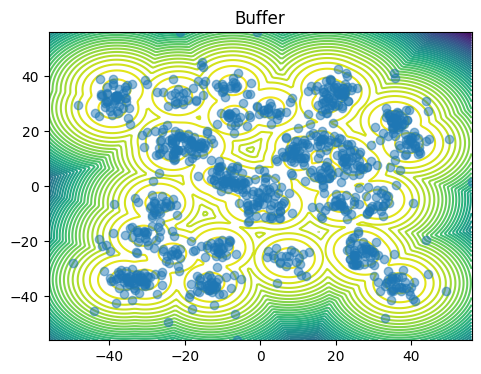

 46%|████▌     | 46/100 [05:17<06:19,  7.03s/it]

Epoch 0 | Loss 2.618567
Epoch 49 | Loss 2.141605
Epoch 98 | Loss 2.188105


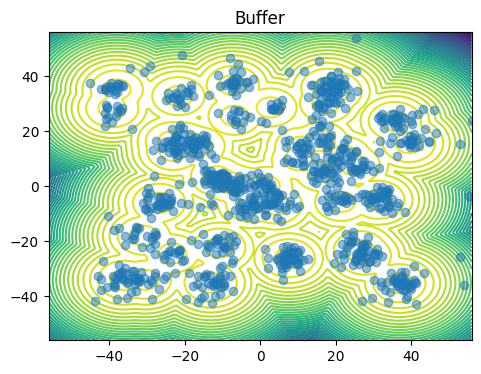

 47%|████▋     | 47/100 [05:24<06:12,  7.02s/it]

Epoch 0 | Loss 6.427176
Epoch 49 | Loss 2.247216
Epoch 98 | Loss 3.225891


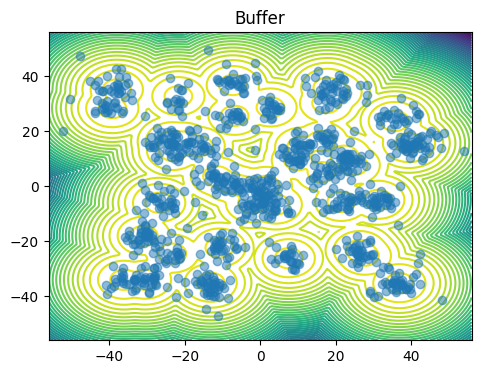

 48%|████▊     | 48/100 [05:31<06:05,  7.03s/it]

Epoch 0 | Loss 2.683597
Epoch 49 | Loss 2.318685
Epoch 98 | Loss 1.937780


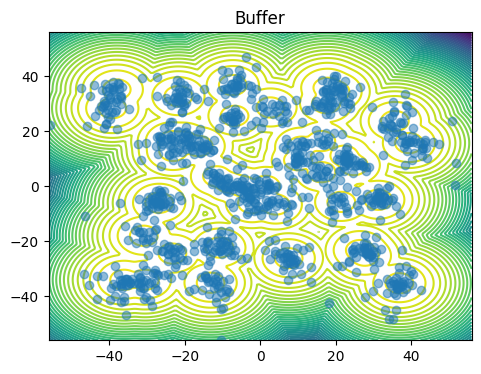

 49%|████▉     | 49/100 [05:38<05:57,  7.00s/it]

Epoch 0 | Loss 4.327407
Epoch 49 | Loss 2.627137
Epoch 98 | Loss 2.149724


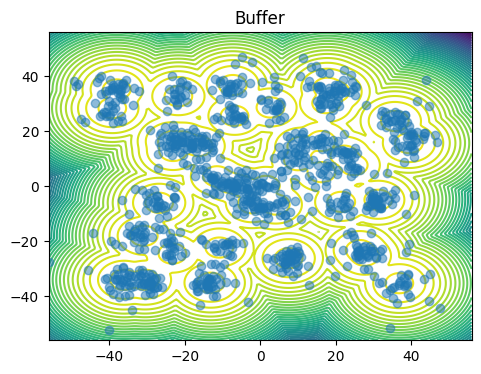

 50%|█████     | 50/100 [05:45<05:47,  6.95s/it]

Epoch 0 | Loss 7.784746
Epoch 49 | Loss 3.099915
Epoch 98 | Loss 4.526136


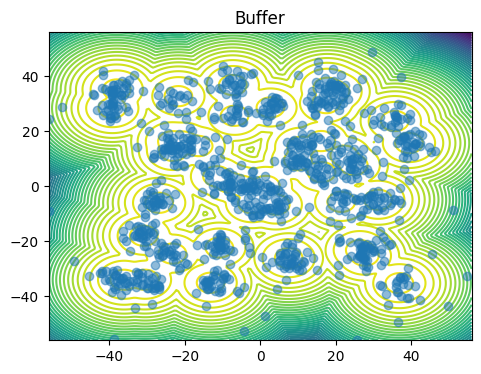

 51%|█████     | 51/100 [05:52<05:44,  7.03s/it]

Epoch 0 | Loss 2.538036
Epoch 49 | Loss 2.412207
Epoch 98 | Loss 2.925090


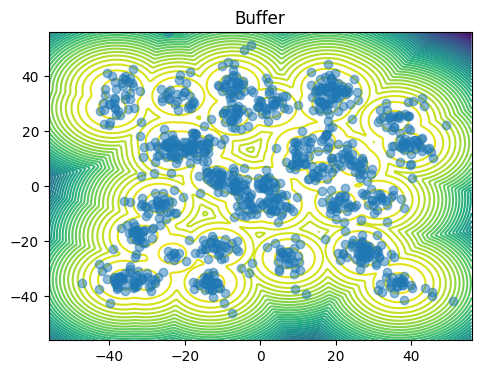

 52%|█████▏    | 52/100 [05:59<05:38,  7.04s/it]

Epoch 0 | Loss 6.171459
Epoch 49 | Loss 3.328579
Epoch 98 | Loss 2.880631


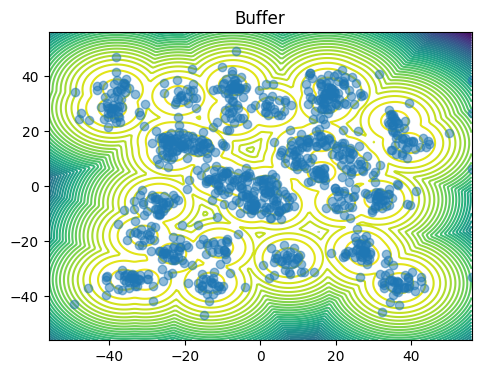

 53%|█████▎    | 53/100 [06:06<05:30,  7.03s/it]

Epoch 0 | Loss 2.898700
Epoch 49 | Loss 4.683115
Epoch 98 | Loss 3.497278


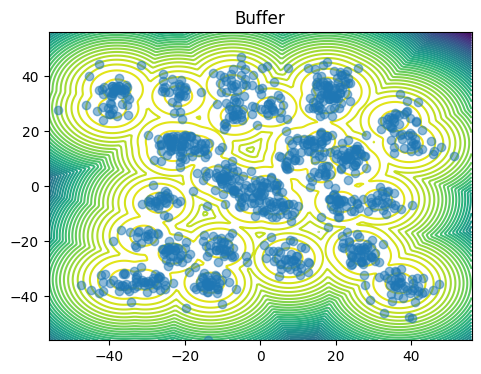

 54%|█████▍    | 54/100 [06:13<05:22,  7.00s/it]

Epoch 0 | Loss 3.614266
Epoch 49 | Loss 5.045659
Epoch 98 | Loss 2.776886


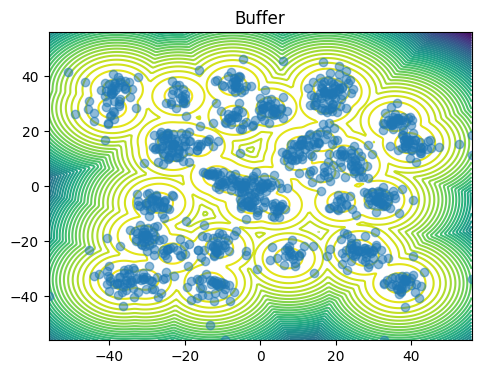

 55%|█████▌    | 55/100 [06:23<05:51,  7.81s/it]

Epoch 0 | Loss 2.142875
Epoch 49 | Loss 3.562251
Epoch 98 | Loss 9.002416


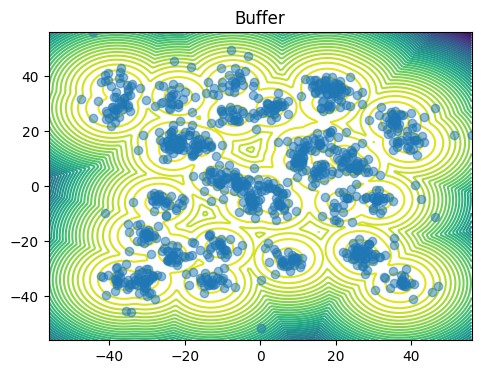

 56%|█████▌    | 56/100 [06:29<05:30,  7.52s/it]

Epoch 0 | Loss 2.946985
Epoch 49 | Loss 2.946684
Epoch 98 | Loss 2.038797


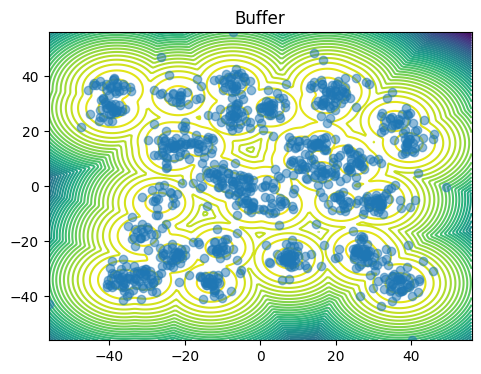

 57%|█████▋    | 57/100 [06:36<05:18,  7.40s/it]

Epoch 0 | Loss 2.012607
Epoch 49 | Loss 2.107612
Epoch 98 | Loss 3.200930


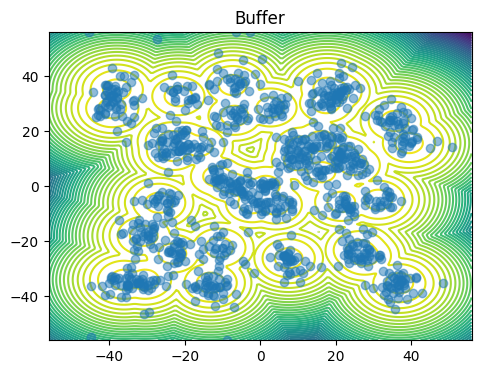

 58%|█████▊    | 58/100 [06:44<05:07,  7.31s/it]

Epoch 0 | Loss 2.407469
Epoch 49 | Loss 2.897662
Epoch 98 | Loss 2.095983


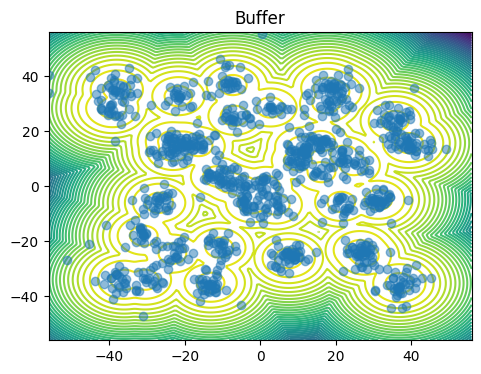

 59%|█████▉    | 59/100 [06:51<04:56,  7.23s/it]

Epoch 0 | Loss 3.043764
Epoch 49 | Loss 2.727452
Epoch 98 | Loss 2.010275


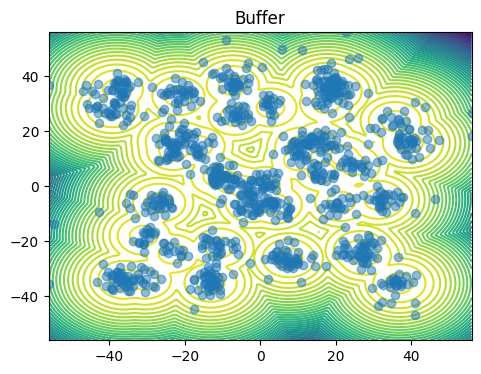

 60%|██████    | 60/100 [06:57<04:44,  7.10s/it]

Epoch 0 | Loss 3.078417
Epoch 49 | Loss 3.185054
Epoch 98 | Loss 3.225381


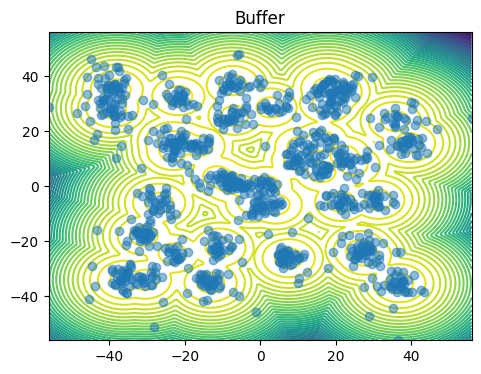

 61%|██████    | 61/100 [07:05<04:38,  7.13s/it]

Epoch 0 | Loss 2.457093
Epoch 49 | Loss 4.172306
Epoch 98 | Loss 2.306555


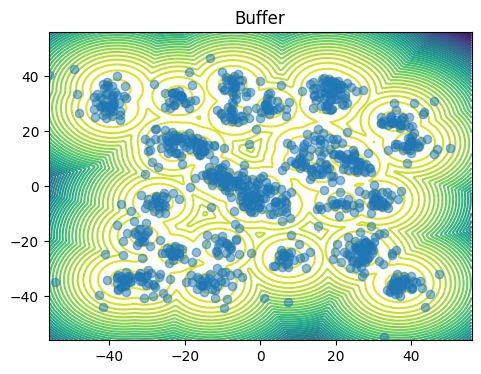

 62%|██████▏   | 62/100 [07:11<04:27,  7.04s/it]

Epoch 0 | Loss 2.170675
Epoch 49 | Loss 1.604079
Epoch 98 | Loss 3.919462


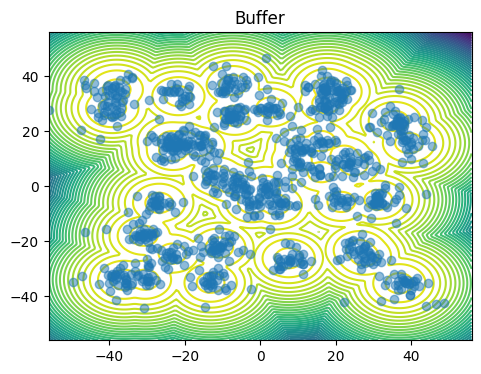

 63%|██████▎   | 63/100 [07:19<04:20,  7.05s/it]

Epoch 0 | Loss 4.965851
Epoch 49 | Loss 2.821956
Epoch 98 | Loss 2.519441


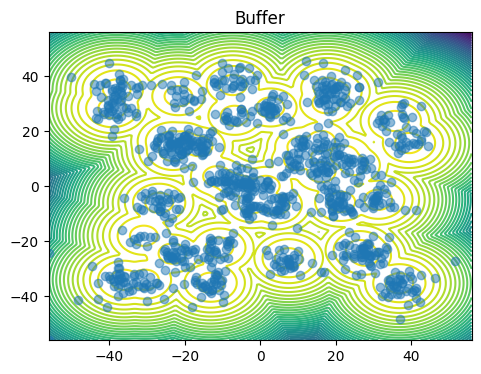

 64%|██████▍   | 64/100 [07:25<04:12,  7.02s/it]

Epoch 0 | Loss 3.477308
Epoch 49 | Loss 3.732130
Epoch 98 | Loss 4.455810


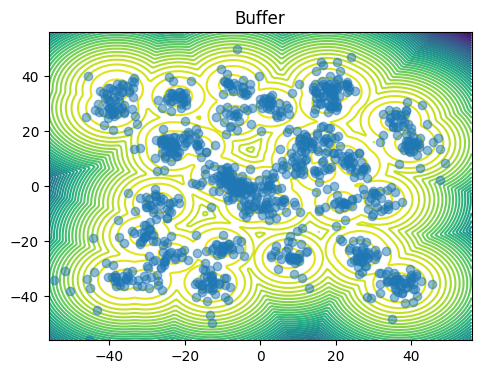

 65%|██████▌   | 65/100 [07:33<04:07,  7.06s/it]

Epoch 0 | Loss 4.291358
Epoch 49 | Loss 3.829831
Epoch 98 | Loss 5.164483


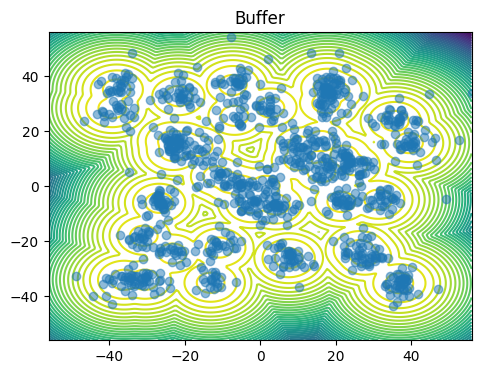

 66%|██████▌   | 66/100 [07:40<03:58,  7.03s/it]

Epoch 0 | Loss 2.152641
Epoch 49 | Loss 2.138824
Epoch 98 | Loss 3.533071


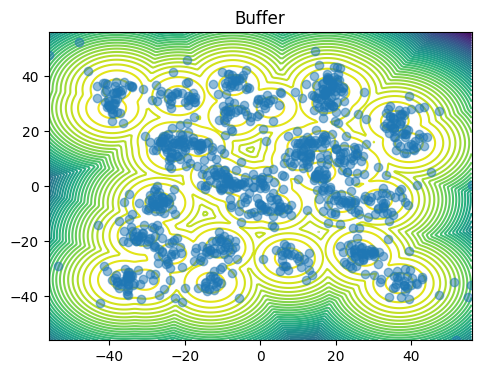

 67%|██████▋   | 67/100 [07:47<03:53,  7.09s/it]

Epoch 0 | Loss 2.282118
Epoch 49 | Loss 3.994157
Epoch 98 | Loss 5.190970


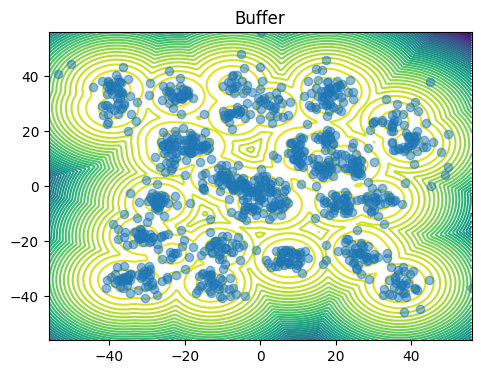

 68%|██████▊   | 68/100 [07:54<03:44,  7.02s/it]

Epoch 0 | Loss 2.477798
Epoch 49 | Loss 2.308583
Epoch 98 | Loss 2.297875


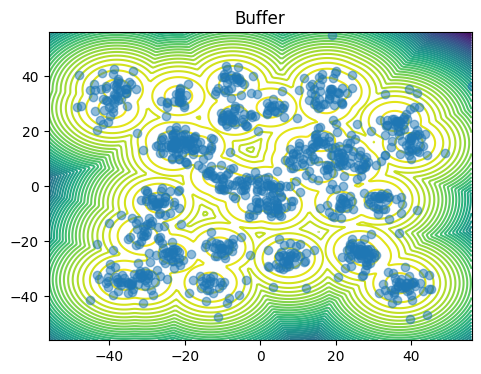

 69%|██████▉   | 69/100 [08:01<03:39,  7.10s/it]

Epoch 0 | Loss 6.753851
Epoch 49 | Loss 2.506461
Epoch 98 | Loss 3.572662


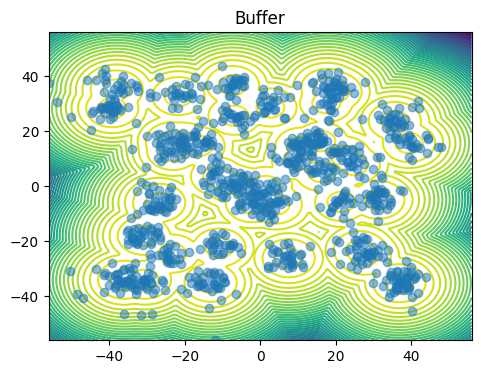

 70%|███████   | 70/100 [08:08<03:31,  7.07s/it]

Epoch 0 | Loss 4.751046
Epoch 49 | Loss 2.277959
Epoch 98 | Loss 2.360488


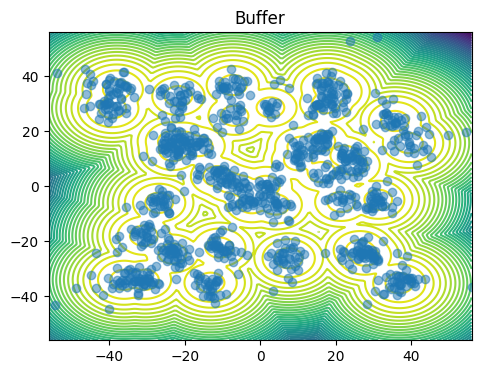

 71%|███████   | 71/100 [08:15<03:24,  7.04s/it]

Epoch 0 | Loss 3.643612
Epoch 49 | Loss 2.587870
Epoch 98 | Loss 2.844295


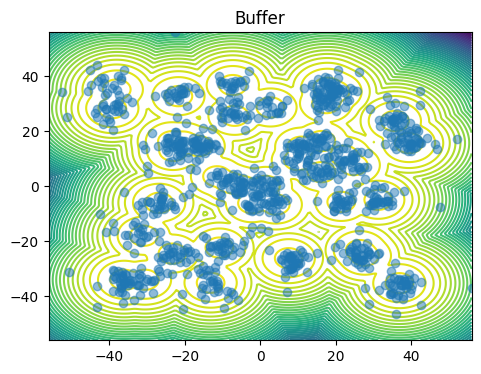

 72%|███████▏  | 72/100 [08:22<03:16,  7.02s/it]

Epoch 0 | Loss 2.558745
Epoch 49 | Loss 2.670767
Epoch 98 | Loss 2.793570


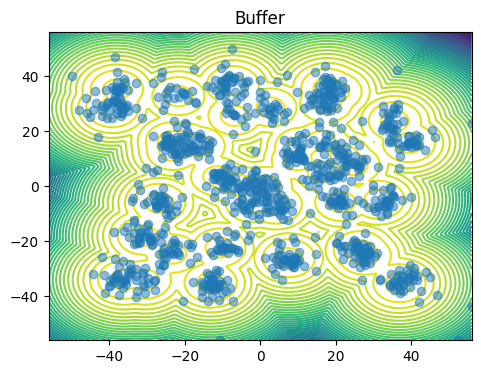

 73%|███████▎  | 73/100 [08:29<03:11,  7.08s/it]

Epoch 0 | Loss 2.627209
Epoch 49 | Loss 2.151513
Epoch 98 | Loss 2.021184


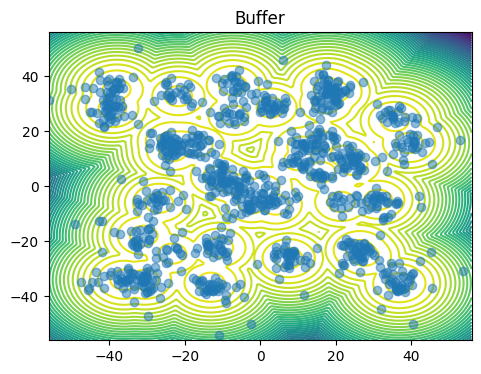

 74%|███████▍  | 74/100 [08:36<03:02,  7.02s/it]

Epoch 0 | Loss 3.322156
Epoch 49 | Loss 1.702747
Epoch 98 | Loss 3.964815


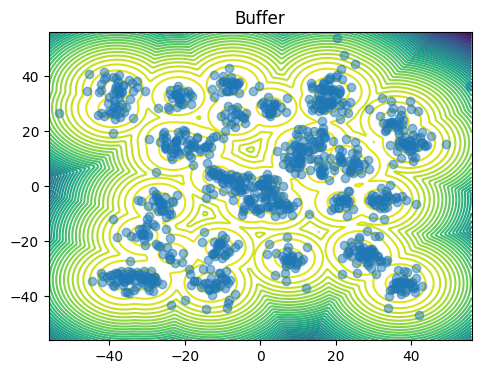

 75%|███████▌  | 75/100 [08:43<02:55,  7.03s/it]

Epoch 0 | Loss 2.435844
Epoch 49 | Loss 4.700536
Epoch 98 | Loss 1.870947


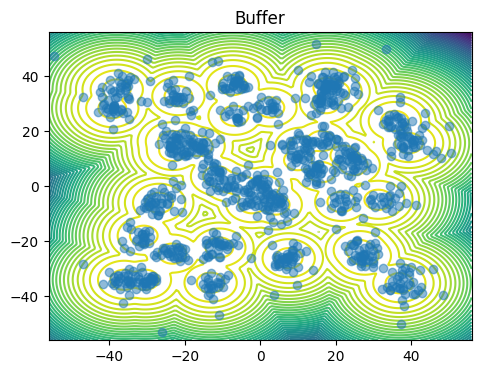

 76%|███████▌  | 76/100 [08:50<02:49,  7.08s/it]

Epoch 0 | Loss 2.223947
Epoch 49 | Loss 2.984889
Epoch 98 | Loss 1.950004


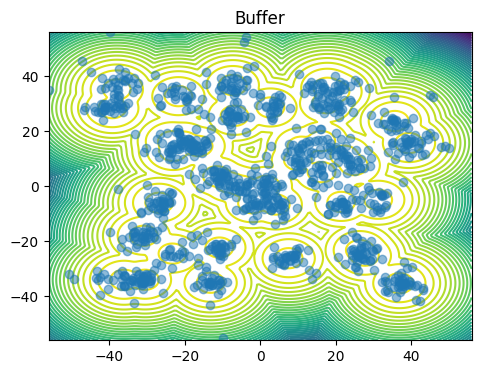

 77%|███████▋  | 77/100 [08:57<02:42,  7.07s/it]

Epoch 0 | Loss 2.544192
Epoch 49 | Loss 2.937778
Epoch 98 | Loss 2.587489


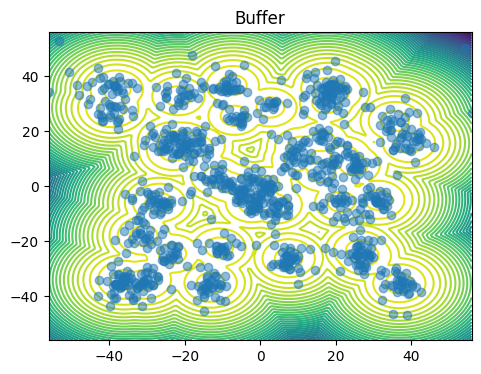

 78%|███████▊  | 78/100 [09:04<02:34,  7.01s/it]

Epoch 0 | Loss 2.120228
Epoch 49 | Loss 2.604257
Epoch 98 | Loss 5.634155


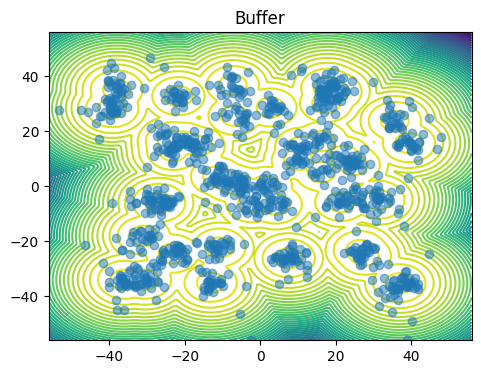

 79%|███████▉  | 79/100 [09:11<02:28,  7.05s/it]

Epoch 0 | Loss 2.359029
Epoch 49 | Loss 2.268949
Epoch 98 | Loss 3.723222


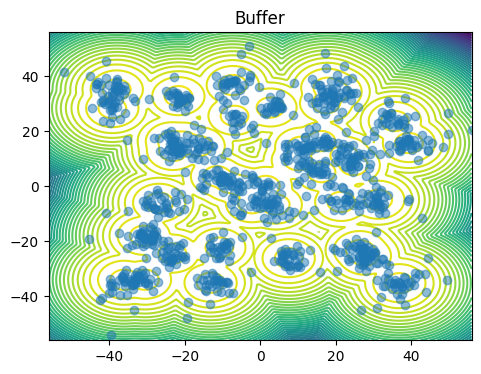

 80%|████████  | 80/100 [09:18<02:20,  7.01s/it]

Epoch 0 | Loss 3.515772
Epoch 49 | Loss 2.689941
Epoch 98 | Loss 3.122586


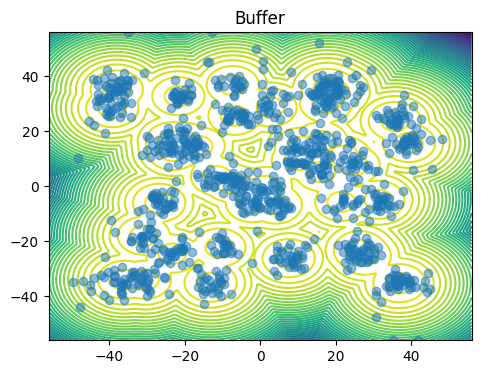

 81%|████████  | 81/100 [09:25<02:13,  7.00s/it]

Epoch 0 | Loss 2.253293
Epoch 49 | Loss 2.845472
Epoch 98 | Loss 1.900072


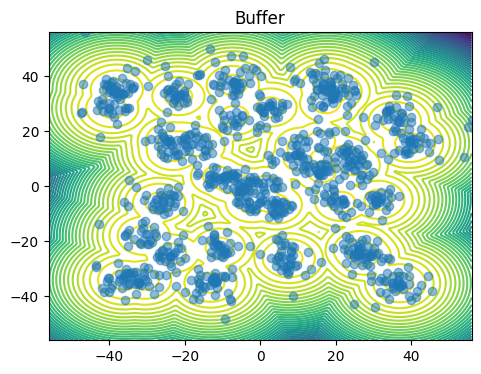

 82%|████████▏ | 82/100 [09:32<02:07,  7.08s/it]

Epoch 0 | Loss 1.776409
Epoch 49 | Loss 2.823273
Epoch 98 | Loss 3.948763


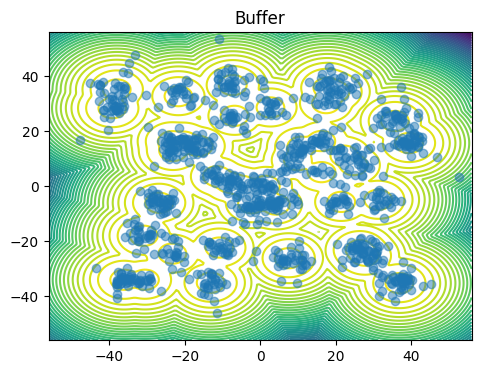

 83%|████████▎ | 83/100 [09:40<02:00,  7.07s/it]

Epoch 0 | Loss 1.929107
Epoch 49 | Loss 2.964127
Epoch 98 | Loss 2.371957


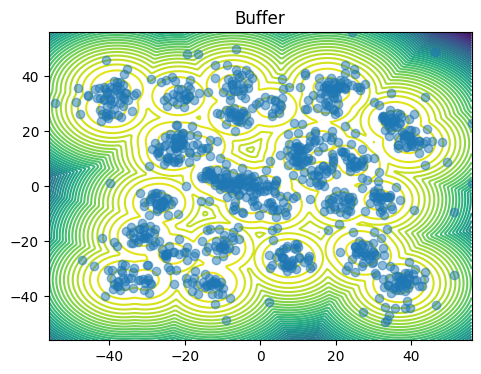

 84%|████████▍ | 84/100 [09:47<01:52,  7.05s/it]

Epoch 0 | Loss 4.438186
Epoch 49 | Loss 8.176481
Epoch 98 | Loss 2.085749


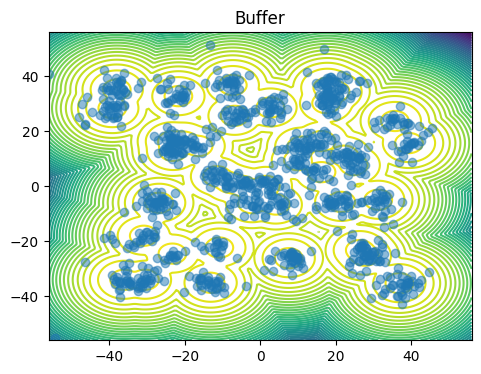

 85%|████████▌ | 85/100 [09:54<01:47,  7.14s/it]

Epoch 0 | Loss 3.904802
Epoch 49 | Loss 1.913187
Epoch 98 | Loss 3.257077


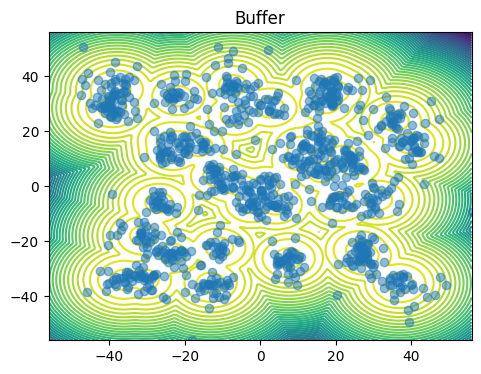

 86%|████████▌ | 86/100 [10:01<01:39,  7.08s/it]

Epoch 0 | Loss 2.392160
Epoch 49 | Loss 3.023006
Epoch 98 | Loss 2.216956


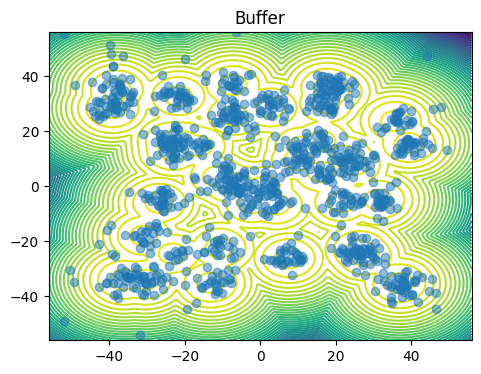

 87%|████████▋ | 87/100 [10:08<01:31,  7.05s/it]

Epoch 0 | Loss 3.972034
Epoch 49 | Loss 2.472753
Epoch 98 | Loss 3.943890


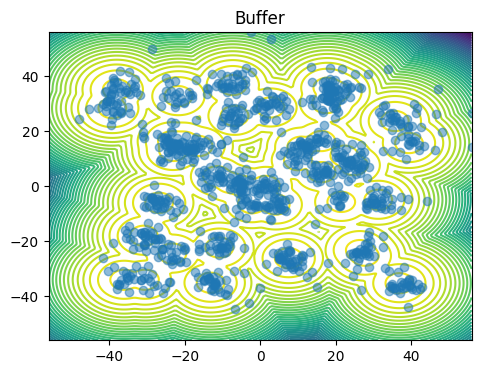

 88%|████████▊ | 88/100 [10:15<01:24,  7.08s/it]

Epoch 0 | Loss 1.951420
Epoch 49 | Loss 4.644408
Epoch 98 | Loss 2.714501


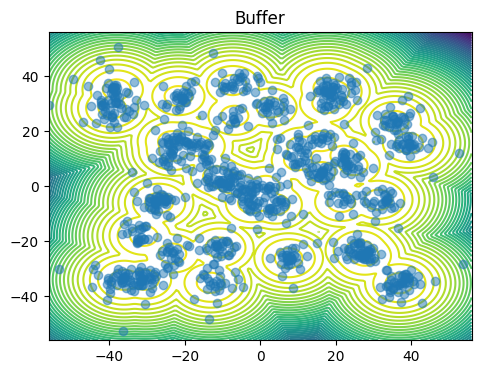

 89%|████████▉ | 89/100 [10:22<01:18,  7.10s/it]

Epoch 0 | Loss 2.366971
Epoch 49 | Loss 6.908294
Epoch 98 | Loss 2.596410


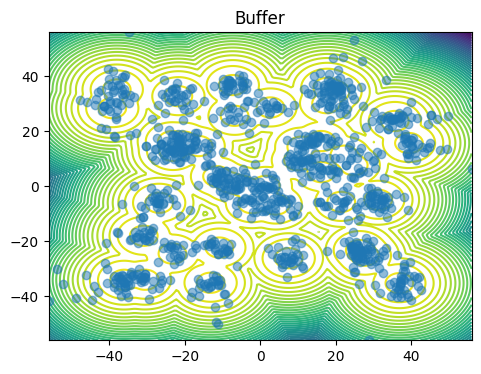

 90%|█████████ | 90/100 [10:29<01:10,  7.02s/it]

Epoch 0 | Loss 3.658143
Epoch 49 | Loss 2.217994
Epoch 98 | Loss 2.754953


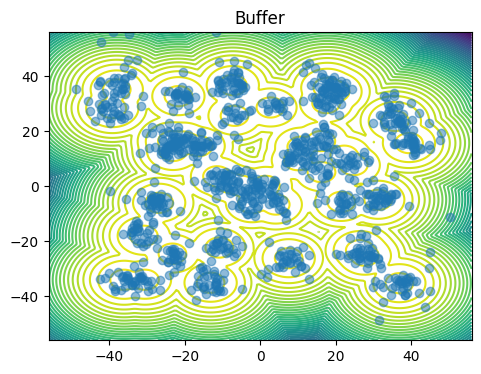

 91%|█████████ | 91/100 [10:36<01:03,  7.05s/it]

Epoch 0 | Loss 2.261729
Epoch 49 | Loss 3.524220
Epoch 98 | Loss 4.149687


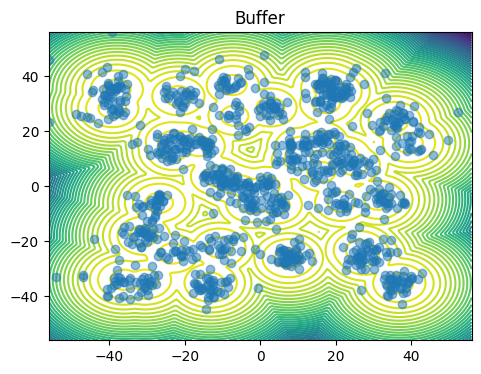

 92%|█████████▏| 92/100 [10:43<00:56,  7.00s/it]

Epoch 0 | Loss 2.722697
Epoch 49 | Loss 2.442639
Epoch 98 | Loss 3.214939


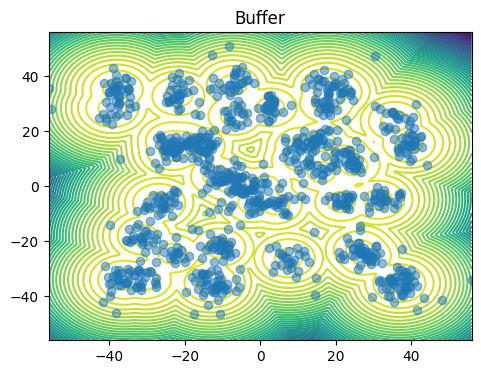

 93%|█████████▎| 93/100 [10:50<00:49,  7.03s/it]

Epoch 0 | Loss 2.794058
Epoch 49 | Loss 2.738884
Epoch 98 | Loss 5.480651


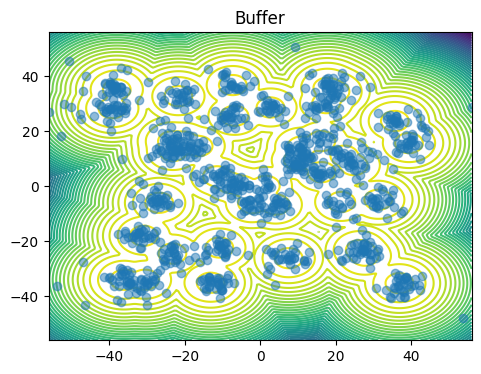

 94%|█████████▍| 94/100 [10:57<00:42,  7.06s/it]

Epoch 0 | Loss 2.811304
Epoch 49 | Loss 7.316648
Epoch 98 | Loss 2.231650


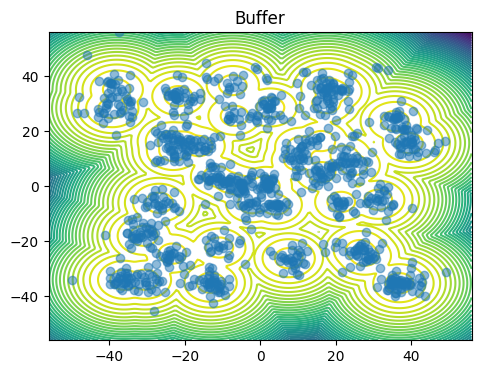

 95%|█████████▌| 95/100 [11:04<00:35,  7.06s/it]

Epoch 0 | Loss 2.386459
Epoch 49 | Loss 2.480474
Epoch 98 | Loss 1.654973


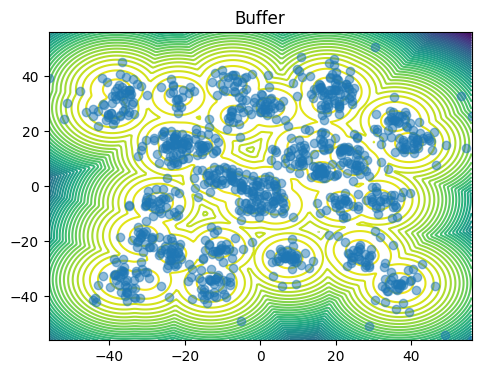

 96%|█████████▌| 96/100 [11:11<00:28,  7.01s/it]

Epoch 0 | Loss 2.998513
Epoch 49 | Loss 2.524786
Epoch 98 | Loss 2.552812


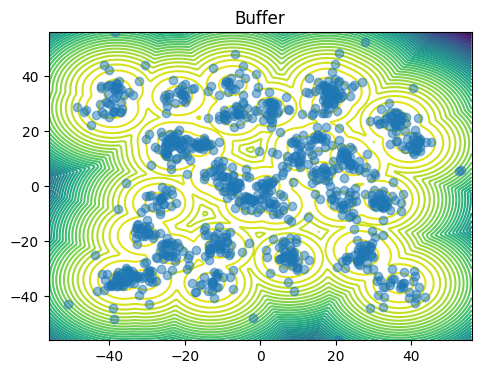

 97%|█████████▋| 97/100 [11:18<00:21,  7.07s/it]

Epoch 0 | Loss 2.239822
Epoch 49 | Loss 3.115911
Epoch 98 | Loss 2.727136


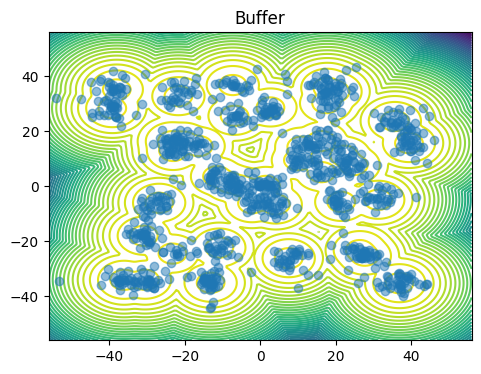

 98%|█████████▊| 98/100 [11:25<00:14,  7.00s/it]

Epoch 0 | Loss 2.473840
Epoch 49 | Loss 2.026552
Epoch 98 | Loss 3.238371


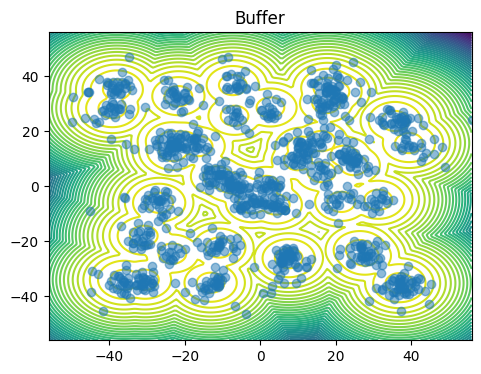

 99%|█████████▉| 99/100 [11:32<00:07,  7.00s/it]

Epoch 0 | Loss 2.646388
Epoch 49 | Loss 3.571748
Epoch 98 | Loss 2.249494


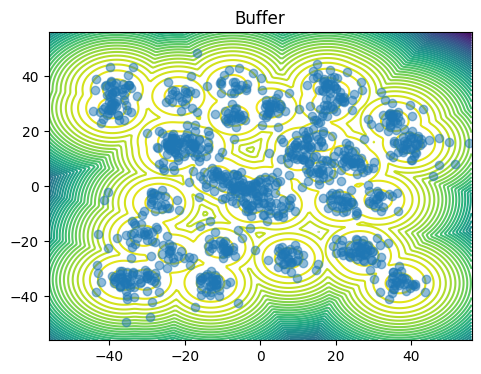

100%|██████████| 100/100 [11:39<00:00,  7.00s/it]


In [34]:
for epoch in tqdm(range(outer_epochs)):
    target = GMM(dimensionality=2,
             n_mixes=40,
             loc_scaling= 40,
             log_var_scaling=1.0,
             device=device,
             should_unnormalize=True)
    
    for epoch in range(inner_epochs):
        total_loss = 0.
        for samples,_ in trainloader:
            samples = samples.to(device)
            optimizer.zero_grad()

            t = torch.rand(len(samples), device=device)
            num_mc_samples = 100

            # rm_loss = posterior_loss(vectorfield, target,
            #                         samples, t, 
            #                         noise_schedule,
            #                         num_mc_samples=num_mc_samples) 
            rm_loss = reward_matching_loss_biased(vectorfield, target,
                                    samples, t, 
                                    noise_schedule,
                                    num_mc_samples=num_mc_samples) 
            loss = rm_loss.mean()
            total_loss += loss.item()
            loss.backward()
            optimizer.step()

        if epoch % 49 == 0:
            print("Epoch %d | Loss %f" % (epoch, loss.item()))


    # Generate samples using the network
    ve_reverse_sde = VEReverseSDE(vectorfield, noise_schedule)
    samples = generate_samples(ve_reverse_sde, 1000, return_full_trajectory=False, diffusion_scale=1.5)

    
    samples_energy = target(samples)

    # Update Buffer 
    buffer.add(samples, samples_energy)

    target.get_dataset_fig(target.unnormalize(samples))
    plt.show()

    # Resample data from the buffer
    samples, samples_energy, _ = buffer.sample(512 * 10)
    train_dataset = TensorDataset(samples, samples_energy)
    trainloader = DataLoader(train_dataset, batch_size = 512, shuffle=True)